# Bilderstapel und  3D-Visualisierung
***

Nachdem wir uns im ersten Teil die Visualisierung von Daten aus Dataframes angeschaut haben, möchten wir uns nun damit beschäftigen, wie wir aus einem Stapel von Bildern eine 3D Darstellung generieren können.


## Aufgabenbeschreibung

3D Visualisierungen sind in der heutigen Medizintechnik nicht mehr wegzudenken. Du kennst sicherlich Verfahren wie die Computertomographie oder Magnetresonanztherapie. 

Deren Ergebnisse sind Stapel von, zum Teil mehreren hundert Schnitt- bzw. Schichtbildern, primär in der Transversalebene.
Als Transversalebene, auch Transaxialebene genannt, wird in der Anatomie eine Ebene bezeichnet, die im rechten Winkel zur Längsachse quer liegt. Sie spannt sich bei lotrechter Längsachse horizontal aus und erstreckt sich beim aufrecht stehenden Menschen von vorne nach hinten, wie von links nach rechts.<br>
<br>
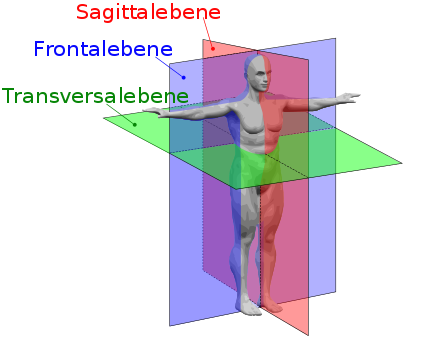<br>
Es besteht die Möglichkeit aus diesen *Originalbildern* weitere Ebenen für eine Visualisierung zu berechnen. Eine weitere Option ist, den Bildstapel einer Ebene als Basis für eine 3D-Visualisierung zu nutzen.

Innerhalb dieses Teil des Workshops wollen wir zwei Ziele erreichen:
1. Umgang mit Bilderstapeln und deren Visualisierung sowie die Verarbeitung der einzelnen Schichtbilder, um sie für die 3D-Rekonstruktion nutzen zu können
2. Rekonstruktion und Visualisierung eines 3D-Modells auf Basis des (vorverarbeiteten) Bildstapels 

Den, in dieser Übung zu verwendenden Bildstapel kannst du dir unter folgendem Link herunterladen:  (<https://mri.radiology.uiowa.edu/VHDicom/VHFCT1mm/VHF-Shoulder.tar.gz>)

Der Datensatz ist dem *CT Datasets (Visible Female CT Datasets)* des *Visible Human Project* (<https://www.nlm.nih.gov/research/visible/visible_human.html>) entnommen.

### Aufgaben:

**1. Einlesen und Visualisieren des DICOM-Bildstapels**

Wir lesen alle DICOM-Bilder des Verzeichnisses ein und
visualisieren den Bildstapel mit Hilfe eines interaktiven **Sliders**, mit dessen Hilfe durch den Bildstapel navigiert werden kann. 

*Dicom ist das Dateiformat in dem CT Bilder gespeichert werden.*

Wie du es aus dem ersten Teil des Workshops bereits kennst, müssen wir die benötigten Bibliotheken importieren.
Wir benötigen die Folgenden: os, pydicom und ipywidgets.
Im ersten Teil haben wir die Bibliothek pandas verwendet. Hier wollen wir ipywidgets einen Namen zuweisen, z.B. widgets.
Aus der Bibliothek ipywidgets benötigen wir die Methoden interact und fixed.

`import os
import pydicom as pydicom
import ipywidgets as widgets
from ipywidgets import interact, fixed
import matplotlib.pyplot as plt`

Damit unsere Ergebnisse im Notebook angezeigt werden, ist es wichtig dies festzulegen. Dafür stellt uns jupyter notebook ein magic command bereit, dieser heißt 'inline'. 
Magic commands sind spezielle Befehle, die uns bei der Ausführung und Analyse von Daten in unserem Notebook helfen können. Sie fügen eine spezielle Funktionalität hinzu, die mit Python-Code oder der Jupyter-Notebook-Schnittstelle nicht ohne weiteres zu erreichen ist.
Magic commands sind innerhalb des Codes leicht zu erkennen. Sie werden entweder mit '%' eingeleitet, wenn sie in einer Codezeile stehen, oder mit '%%', wenn sie in mehreren Zeilen stehen.
Der Aufruf sieht wie folgt aus:

`%matplotlib inline`

Wir erstellen eine Variable mit dem Namen **image_stack**. Diese Variable soll alle Bilder beinhalten. Um so viele Bilder abzulegen, benötigen wir eine Liste.
Eine Liste kannst du dir wie eine Kommode mit verschiedenen Schubladen vorstellen. Jede dieser Schubladen hat eine Nummer (diese nennen wir Index, beginnend bei 0). In jede Schublade kommt ein Bild - Wir haben also eine sehr große Kommode ;).

`image_stack = []`

Um die Kommode mit Bildern zu befüllen, müssen wir alle Bilder durchgehen und jedes in die richtige Schublade legen. Da wir diese Tätigkeit immer wieder durchführen, nutzen wir hierfür eine Schleife.


Es gibt verschiedene Formen von Schleifen, wir nutzen **for-Schleifen**. Eine Schleife wiederholt einen Anweisungsblock im Programm solange, wie die angegebene Bedingung gültig ist.  
Mit einer for-Schleife kannst du also einen Teil deines Programms wiederholen. Aber wie sagst du deinem Programm, wie oft es sich wiederholen soll? 
Bei Python for-Schleifen machst du das, indem du deinem Programm eine Liste gibst. Für jedes Element in deiner Liste wird der Inhalt deiner Schleife einmal ausgeführt.
Wir wollen pro Bild die **sorted()** Funktion aufrufen, um den Bilderstapel in aufsteigender Reihenfolge zu sortieren. Die **sorted()** bekommt den Pfad zu den Bildern als Übergabewert. In diesem Fall: './Shoulder/', da der Bildstapel im Ordner 'Shoulder' abgelegt ist.

`for file_name in sorted(os.listdir('./Shoulder/')):`


In der Schleife erstellen wir eine neue Variable namens **pixels**, in dieser werden die Bilder als Pixelarray gespeichert, damit wir sie als Bilder verarbeiten können.
Ein Pixelarray umschließt eine Oberfläche und bietet direkten Zugriff auf die Pixel der Oberfläche. Ein Pixelarray kann ein- oder zweidimensional sein.<br>
Als Erstes rufen wir eine Funktion aus der pydicom Bibliothek auf. Es handelt sich um die **read_file()** Funktion. Der Aufruf aus der Bibliothek sieht wie folgt aus:

`pixels = pydicom.read_file('./Shoulder/' + file_name).pixel_array`

In die runden Klammern, kommt wie du siehst der Pfad der Datei. Anschließend ist es wichtig, mit pixel_array festzulegen, dass es sich um ein Pixelarray handelt.
Mit `.pixel_array` am Ende der Zeile wird dies erledigt.
Um die Bilder in image_stack abzulegen, benutzen wir die Funktion **append()**, welche **pixels** als Übergabewert bekommmt.

`image_stack.append(pixels)`

Um zu überprüfen, ob die Bilder erfolgreich gespeichert wurden, lassen wir uns **image_stack** anzeigen. Dies machen wir, indem wir die **print()** Funktion aufrufen und ihr übergeben, dass sie **image_stack** printen soll.

`print(image_stack)`

Damit du das Resultat siehst, musst du auf **Run** klicken.
Nach dieser Überprüfung, solltest du diese Zeile mit **#** am Anfang auskommentieren.

Da wir die Bilder erfolgreich in der Liste **image_stack** gespeichert haben, wollen wir sie auch sehen.

Wir schreiben uns eine Funktion in der wir festlegen, wie die Bilder dargestellt werden sollen.

Eine Funktion in Python schreibst du, indem du mit **def** am Anfang festlegst, dass es sich um eine Funktion handelt. Danach legst du den Namen fest. In diesem Fall: **show_image**. Anschließend legst du die Übergabewerte fest. 
Die Übergabewerte kommen in runde Klammern, hinter den Namen der Funktion. 
Übergabewerte sind Werte, die wir für die Ausführung der Funktion benötigen.

Wir übergeben der Funktion die Werte der Variable **image_stack** und **position**.

Position geben wir an, damit wir später mit einem Slider durch unsere Bilder durchgehen können. image_stack benötigen wir um auf unsere Bilderzuzugreifen. Nach dem Schließen der runden Klammern, setzt du einen Doppelpunkt und schon kann es, in der nächsten Zeile, mit dem Körper der Funktion losgehen.

`def show_image(image_stack, position):`

Hier wollen wir festlegen, wie unsere Bilder angezeigt werden sollen. 
Dazu benötigen wir mehrere Funktionen aus der matplotlib.pyplot Bibliothek. Wir beginnen mit **figure()**, diese nutzen wir, um die Größe des Kastens festzulegen, in dem unsere Bilder angezeigt werden. Wir übergeben der **figure()** Funktion den Übergabewert: **figsize(10,10)**.

`plt.figure(figsize = (10, 10))`

Wir haben in dieser Funktion schon vieles festgelegt, aber wir können immer noch nichts sehen. Das liegt daran, dass wir diese Funktion aufrufen müssen, um sie tatsächlich auszuführen - darum kümmern wir uns jetzt.

Die nächste Funktion die wir nutzen ist **imshow()**. Hier wollen wir uns um den Slider und die Farbgebung kümmern indem wir **image_stack[position], cmap=plt.cm.gray** als Übergabewerte übergeben. Mit **axis()** können wir die Beschriftung der Achsen ausstellen. Dazu setzen wir als Übergabewert **'off'**.
Mit **plt.show** plotten wir die Bilder.

`plt.imshow(image_stack[position], cmap=plt.cm.gray)
 plt.axis('off')
 plt.show()`

Um den Slider zu gestalten, erstellen wir eine neue Variable und rufen aus **widgets** die Funktion **IntSlider()** auf. Diese Funktion benötigt verschiedene Angaben. 
 -Der niedrigste Wert: **min=0**
 -Der höchste Wert: Index des letzten Bildes - 1
 -Größe der Schritte: **step=1** und **value=0**
 -**countinous_update** = **False** zu setzen, da sonst immer wieder nachgeladen wird und ein weißes Flackern beim Sliden entsteht.

`stack_slider = widgets.IntSlider(min=0, max=len(image_stack) - 1, step=1, value=0, continuous_update=False)`

Da der Slider ohne **interact()** keine Funktion hat, rufen wir **interact()** auf und übergeben **show_image** (damit rufen wir die Funktion auf, die wir geschrieben haben). **image_stack** benötigen wir ebenfalls, es soll auch immer noch image_stack bleiben aber fixiert sein, deswegen übergeben wir es wie angegeben. Die Position soll den stack_slider enthalten.


`interact(show_image, image_stack=fixed(image_stack), position=stack_slider);`.

In [1]:
# Aufgabe 1

import os
import pydicom as pydicom
import ipywidgets as widgets
from ipywidgets import interact, fixed
import matplotlib.pyplot as plt

%matplotlib inline

image_stack = []

for file_name in sorted(os.listdir('./Shoulder/')):
    pixels = pydicom.read_file('./Shoulder/' + file_name).pixel_array
    image_stack.append(pixels)
             
def show_image(image_stack, position):
    plt.figure(figsize = (10, 10))
    plt.imshow(image_stack[position], cmap=plt.cm.gray)
    plt.axis('off')
    plt.show()

stack_slider = widgets.IntSlider(min=0, max=len(image_stack) - 1, step=1, value=0, continuous_update=False)    

interact(show_image, image_stack=fixed(image_stack), position=stack_slider);



interactive(children=(IntSlider(value=0, continuous_update=False, description='position', max=449), Output()),…


Wir benötigen noch einige weitere Importe, du kannst alle folgenden Importe übernehmen und entweder zu den Importen oben hinzufügen oder sie in einer neuen Codezelle erstellen.
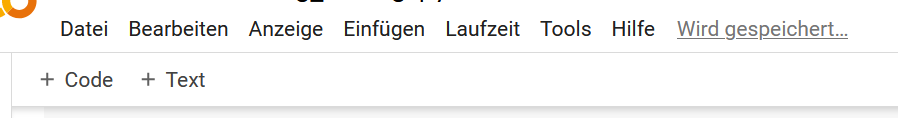<br>
Wenn du hier auf das + neben Code klickst, erscheint ein neues Feld in dem du den Code einfügen kannst.

**2. Konvertierung des DICOM-Bildstapels in Binärbilder**

Wir importieren zunächst wieder unsere benötigten Bibliotheken und Methoden.

`import pathlib
import matplotlib
import skimage
import numpy as np
from skimage import data, draw, io, measure
from skimage.morphology import *
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from plotly.graph_objs import *
from scipy.spatial import Delaunay
from plotly.figure_factory import create_trisurf
import plotly.io as pio
import skimage.morphology as sm`

Damit wir das Objekt und den Hintergrund besser voneinander trennen können, implementieren wir eine Funktion zur Konvertierung eines Bildes in das Binärformat anhand eines gegebenen Schwellenwertes.
Der Hintergrund in CT-Dicom-Bildern zeichnet sich durch vergleichsweise niedrige Signalwerte aus, während das Untersuchungsobjekt hohe Signalwerte aufweist. Um den Hintergrund vom Objekt zu trennen, nutzen wir die binäre Konvertierung.
Unsere Funktion soll die Pixel des Bildes anhand eines Vergleichs mit einem gegebenen Schwellenwert (Funktionsparameter) dem Hintergrund bzw. dem Objekt zuordnen:

- Pixelwert < Schwellenwert: Pixel ist Hintergrundpixel
- Pixelwert >= Schwellenwert: Pixel ist Objektpixel

Wir wenden die Funktion auf alle Bilder des Stapels an und wählen einen Schwellenwert von **250**.

In der Binärschreibweise gibt es nur 0 und 1, wir wollen festlegen, dass alles was kleiner als der Schwellenwert ist, den Wert 0 zugewiesen bekommt. Alles was größer oder gleich dem Schwellenwert ist, soll 1 sein (0 ist schwarz, 1 ist weiß).

Die Visualisierung des Stapels soll dem aus Aufgabe 1 entsprechen.

Wir erstellen eine neue Variable, in der wir den Wert des Schwellenwertes speichern, diese Variable nennen wir **threshold**.

`threshold = 250`

Wir erstellen eine weitere Variable, welche eine Liste enthält und **binary_stack** heißen soll.

`binary_stack = []`

Wir schreiben eine neue Funktion **binary** und wollen dieser zwei Übergabewerte mitgeben. Diese sind **image** und **threshold**.
Diese Funktion gibt den Wert von **(image >= threshold) * 1** zurück. Die ***1** ist lediglich eine Formalität und könnte in diesem Fall weggelassen werden.

`def to_binary(image, threshold):
    return (image >= threshold) * 1`

Da wir diese Funktion für alle Bilder anwenden wollen, benötigen wir eine **for-Schleife**. Sie soll alle Bilder durchlaufen und für jedes Bild die Funktion **binary()** mit den definierten Übergabewerten anwenden. Danach soll das Bild zu der Liste **binary_stack** hinzugefügt werden.

`for image in image_stack:
    binary_stack.append(to_binary(image, threshold))`

Wie in Aufgabe 1 wenden wir die **interact()** Funktion an, übergeben ihr aber an der 2. Stelle **image_stack=fixed(binary_stack)**.

`interact(show_image, image_stack=fixed(binary_stack), position=stack_slider);`

In [3]:
# Aufgabe 2

import pathlib
import matplotlib
import skimage
import numpy as np
from skimage import data, draw, io, measure
from skimage.morphology import *
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from plotly.graph_objs import *
from scipy.spatial import Delaunay
from plotly.figure_factory import create_trisurf
import plotly.io as pio
import skimage.morphology as sm

threshold = 250
binary_stack = []

def to_binary(image, threshold):
    return (image >= threshold) * 1

for image in image_stack:
    binary_stack.append(to_binary(image, threshold))
    
interact(show_image, image_stack=fixed(binary_stack), position=stack_slider);

interactive(children=(IntSlider(value=0, continuous_update=False, description='position', max=449), Output()),…

**3. Optimieren der Binärbilder**

Wir haben bereits alle benötigten Bibliotheken in den beiden vorherigen Aufgaben importiert. 

Die Visualisierung in Aufgabe 2 zeigt, dass einige Bilder kleine Artefakte im Hintergrund oder Löcher im Objekt aufweisen. Die Kanten von Gegenständen sind manchmal sehr abgenutzt dargestellt und auf einigen Bildern erscheint der Bereich der Untersuchungsliege im Bild.

Wir wollen versuchen, diese *ungünstigen* Eigenschaften der Bilder auszugleichen.

1. Bei den Morphologische Operationen (Erosion, Dilatation, Öffnung, Schließung) müssen wir auf die Reihenfolge achten. Sie helfen uns, die Bilder zu optimieren und Störungen zu verringern. 
<br>
2. Wir wollen einen **globalen** Objektbereich definieren und auf alle Bilder anwenden. Alle Pixel außerhalb dieses Objektbereiches werden automatisch zum Hintergrund. 

Wir erstellen eine neue Liste, in der die optimierten Bilder abgespeichert werden.

`morphed_stack = []morphed_stack = []`

Da wir die Funktionen auf alle Bilder in **binary_stack** anwenden wollen, benötigen wir eine **for-Schleife**.

`for i in range(len(binary_stack)):`

Wir erstellen eine Variable, welche den Rahmen darstellt, der mit der Dicke = 6 auf den Scan angewendet wird. Dies machen wir mit der **disk()** Funktion.

`ellipse = disk(6)`

Wir möchten verschiedene Funktionen zur Verbesserung der Bilder anwenden. 
Die benötigten Funktionen sind: **erosion()**, **dilation** und **closing**.
Wir erstellen die Variable **morphed** und speichern in ihr das veränderte Bild **i**. **i** wurde verändert weil die Funktion **binary_erosion()** mit den Übergabewerten **binary[i]** und **ellipse** angewendet wird. Danach werden auf dieses Bild alle weiteren Funktionen angewendet. Ab jetzt wird immer **morphed** in der Funktion als Übergabewert übergeben, während die Variable **morphed** immer den veränderten Wert annimmt.
`morphed = binary_erosion(binary_stack[i], ellipse)
    morphed = binary_dilation(morphed, ellipse)
    morphed = binary_closing(morphed, ellipse)
    morphed = binary_dilation(morphed, ellipse)
    morphed = binary_dilation(morphed, ellipse)
    morphed = binary_closing(morphed, ellipse)
    morphed = binary_dilation(morphed, ellipse)
    morphed = binary_closing(morphed, ellipse)`


Der Liste **morphed_stack** wird mit **append()** und dem Übergabewert **morphed** jedes veränderte Bild hinzugewiesen.

`morphed_stack.append(morphed)`

Wir benötigen nun noch eine Funktion, die uns das Darstellen der Bilder ermöglicht.
Wir schreiben eine neue Funktion und übergeben ihr den Wert von **index**.
Wir benötigen **imshow** und übergeben die Liste **morphed_stack[index]**, um das entsprechende Bild aufzurufen. Anschließend legen wir als colormap = gray fest. 

In der nächsten Zeile stellen wir die Beschriftung der Achsen wieder aus und plotten danach.

`def morphological_display(index):
    plt.imshow(morphed_stack[index], cmap=plt.cm.gray)
    plt.axis("off")
    plt.show()`

Wir dürfen unseren Slider auch jetzt nicht vergessen und passen ihn an der 3. Stelle der Übergabewerte erneut an

`slider = widgets.IntSlider(value=0, min=0, max = len(morphed_stack)-1, step=1, continuous_update=False);`

Der **interact()** Funktion übergeben wir **morphological_display** und **index=slider**.

`interact(morphological_display, index=slider)`

In [4]:
morphed_stack = []
for i in range(len(binary_stack)):
    ellipse = disk(6)
    morphed = binary_erosion(binary_stack[i], ellipse)
    morphed = binary_dilation(morphed, ellipse)
    morphed = binary_closing(morphed, ellipse)
    morphed = binary_dilation(morphed, ellipse)
    morphed = binary_dilation(morphed, ellipse)
    morphed = binary_closing(morphed, ellipse)
    morphed = binary_dilation(morphed, ellipse)
    morphed = binary_closing(morphed, ellipse)
    morphed_stack.append(morphed)
    
def morphological_display(index):
    plt.imshow(morphed_stack[index], cmap=plt.cm.gray)
    plt.axis("off")
    plt.show()
    
slider = widgets.IntSlider(value=0, min=0, max = len(morphed_stack)-1, step=1, continuous_update=False);
interact(morphological_display, index=slider)

interactive(children=(IntSlider(value=0, continuous_update=False, description='index', max=449), Output()), _d…

<function __main__.morphological_display(index)>

Wir erstellen die Liste **otimized_stack**.

`optimized_stack = []`

Anschließend definieren wir eine **for-Schleife**, welche über die Länge des **morphed_stack** iteriert.

`for i in range(len(morphed_stack)):`

Der neuen Variable **optimized** wird das Bild zugewiesen, welches sich in **morphed_stack** an der Stelle **[i]** befindet.

`optimized = morphed_stack[i]`

Wir erstellen eine Maske, die über die gesamte Achse gelegt wird. **np.ones(shape)** nimmt die Größe der optimierten Liste an, damit die Liste beim plotten komplett bedeckt wird.

`mask = np.ones(shape=optimized.shape[0:2], dtype= "bool")`

Die Maske benötigt 2 Punkte um ein Rechteck zu bilden.

`point1, point2 = skimage.draw.rectangle(start=(98, 20), end=(370, 495))`

Die Maske, welche über den gesamten Scan geht, soll bei den Koordinaten, die den Kopf framen, den Wert False geben. Es ist wichtig den **dtype=bool** zu definieren, damit die Maske an der Stelle des Rechtecks durchsichtig bleibt (wie ein Fenster), während alles andere (durch den Binärwert) die Farbe schwarz zugewiesen bekommt.

`mask[point1, point2] = False
optimized[mask] = 0
optimized_stack.append(optimized)`


In [5]:
optimized_stack = []
for i in range(len(morphed_stack)):
    optimized = morphed_stack[i]
    mask = np.ones(shape=optimized.shape[0:2], dtype= "bool")
    point1, point2 = skimage.draw.rectangle(start=(98, 20), end=(370, 495))
    mask[point1, point2] = False
    optimized[mask] = 0
    optimized_stack.append(optimized)

Wir definieren eine neue Funktion mit dem Übergabewert **index**. Hier wollen wir wieder **imshow()** aufrufen. Der Übergabewert an der dritten Stellen ist hier **optimized_stack[index]**, die Farbe ist **gray**, danach wird geplottet.

`def sectionized_display(index):
    plt.imshow(optimized_stack[index], cmap=plt.cm.gray)
    plt.show()`

Beim Slider wird die übliche Stelle angepasst. In die Klammer kommt nun **optimized_stack**

`slider = widgets.IntSlider(value=0,min=0, max = len(optimized_stack)-1, step=1, continuous_update=False);`

Der Aufruf der Funktion **interact()** erfolgt mit **sectionizied_display** und **index=slider** als Übergabewert.

`interact(sectionized_display, index=slider)interact(sectionized_display, index=slider)`

In [6]:
def sectionized_display(index):
    plt.imshow(optimized_stack[index], cmap=plt.cm.gray)
    plt.show()
    
slider = widgets.IntSlider(value=0,min=0, max = len(optimized_stack)-1, step=1, continuous_update=False);
interact(sectionized_display, index=slider)

interactive(children=(IntSlider(value=0, continuous_update=False, description='index', max=449), Output()), _d…

<function __main__.sectionized_display(index)>

**4. 3D-Rekonstruktion**

Basierend auf den Binärbildern aus der dritten Aufgabe, wollen wir ein 3D-Modell des Datensatzes rekonstruieren.

Grundsätzlich stehen für eine Rekonstruktion verschiedene Ansätze zur Auswahl, u.a.:
- Detektion der Außenkonturen der Objekte und anschließende Triangulation der Oberfläche (Bildung von Dreiecken).
- Anwendung des sog. "Marching-Cubes-Algorithmus" (skimage-Bibliothek: measure.marching_cubes_lewiner())
- Konstruktion eines Volumenmodells aus den Objektvoxeln der gestapelten Schichten

Wir wollen diese Aufgabe mit dem "Marching-Cubes-Algorithmus" umsetzen.

Wir benötigen eine neue Liste.

`plot_array = []`

Anschließend definieren wir eine **for-Schleife**. Die **for-Schleife** läuft über jedes **optimized** in **optimized_stack**. In dieser Schleife wird für jedes **otimized** der **dtype** auf **"int"** gesetzt.

`for optimized in optimized_stack:
    optimized.dtype = "int"`
    
Dann fügen wir der eben erstellten Liste das jeweilige Ergebnis zu. 

`plot_array.append(optimized)`


In [7]:
plot_array = []
for optimized in optimized_stack:
    optimized.dtype = "int"
    plot_array.append(optimized)

Wir definieren eine neue Funtion namens **mesh**, übergeben ihr **images_stack** und legen die Schritte fest, innerhalb derer sich bewegt werden soll. 

`def mesh(images_stack, step=1):`

In dieser Funktion erstellen wir eine neue Variable **binary_images**. 

Wir wandeln die Liste **images_stack** in ein **numpy Array** um, da die Funktion die wir zur Erstellung unseres 3D Modells benötigen, ein Array als Übergabewert erwartet.

Numpy ist das grundlegende Paket für wissenschaftliches Rechnen mit Python und bietet uns die Möglichkeit, Listen in Arrays umzuwandeln. Für diese Aufgabe reicht es zu verstehen, dass du dir Python Listen und numpy Arrays vom Aufbau her gleich vorstellen kannst. 
Dies geschieht mit der Funktion **np.transpose()** mit **images_stack** als Übergabewert.

`binary_images = np.transpose(images_stack)`

Wir legen fest folgende Werte für **verts, faces, norm, val** fest:

`verts, faces, norm, val = measure.marching_cubes(binary_images, step_size=step, allow_degenerate=True) `

 **measure.marching_cubes()** ist eine Funktion, die festlegt wie unsere 3D Darstellung generiert wird.
Die Rückgabewerte dieser Funktion sind **verts** und **faces**.

`return verts, faces`

In [8]:
def mesh(images_stack, step=1):
    binary_images = np.transpose(images_stack)
    verts, faces, norm, val = measure.marching_cubes(binary_images, step_size=step, allow_degenerate=True) 
    return verts, faces

An dieser Stelle müsen wir festlegen, wie unsere Darstellung aussehen soll.
Wir erstellen eine neue Funktion **threeD_display** mit den Übergabewerten **verts** und **faces**.

`def threeD_display(verts, faces):`

Wir erstelle die Variablen x, y, z welche alle die Werte der Funktion **zip()** zugewiesen bekommen. Diese Funktion bekommt die Übergabewerte ***verts**.

`x,y,z = zip(*verts)`

Anschließend muss **figure** festgelegt werden. Das kennen wir schon aus der ersten Aufgabe und können es hier genauso machen.

`figure = plt.figure(figsize=(10, 10))`

Nachdem wir das erledigt haben, erstellen wir die Variable **ax**. An dieser Stelle fügen wir subplots hinzu.

`ax = figure.add_subplot(111, projection='3d')ax = figure.add_subplot(111, projection='3d')`

Die nächste Variable die wir benötigen ist **mesh**.

`[mesh = Poly3DCollection(verts[faces], linewidths=0.05, alpha=1)`

Wir benötigen nun noch Angaben für die Variable **face_color**.<br> Diese sollten sein **[1, 1, 0.9]**.

`face_color = [1, 1, 0.9]`

Wir wollen nun auf **mesh** die Funktion **set_facecolor()** anwenden, um die **face_color** auf das mesh zu übertragen. Demzufolge muss der Übergabeparameter auch **face_color** sein.<br>

`mesh.set_facecolor(face_color)`

Auf die Variable **ax** wenden wir die Funktion **add_collection3d()** an und übergeben **mesh**.

`ax.add_collection3d(mesh)`

Wir setzen für **ax** die Limits für x, y, und z. 

`ax.set_xlim(0, max(x))
ax.set_ylim(0, max(y))
ax.set_zlim(0, max(z))`

Bevor wir plotten können, müssen wir auch für **ax** die facecolor festlegen.

`[ ] ax.set_facecolor((0.7, 0.7, 0.7))`

Danach können wir plotten.

`plt.show()plt.show()`

Nachdem wir unsere Funktion fertiggestellt haben, weisen wir den neuen Variablen **v** und **f** auf einer Zeile die Werte aus **mesh(plot_array)** zu.

`v, f = mesh(plot_array) # für normales 3d`

Wir rufen jetzt die Funktion die wir gerade geschrieben haben auf und übergeben ihr **v** und **f**. Diese stehen für **verts** und **faces**, welche wir bei der Erstellung der Funktion als Übergabewerte festgelegt haben.

`threeD_display(v, f)`

In [9]:
def threeD_display(verts, faces):
    x,y,z = zip(*verts) 
    figure = plt.figure(figsize=(10, 10))
    ax = figure.add_subplot(111, projection='3d')
    mesh = Poly3DCollection(verts[faces], linewidths=0.05, alpha=1)
    face_color = [1, 1, 0.9]
    mesh.set_facecolor(face_color)
    ax.add_collection3d(mesh)

    ax.set_xlim(0, max(x))
    ax.set_ylim(0, max(y))
    ax.set_zlim(0, max(z))
    ax.set_facecolor((0.7, 0.7, 0.7))
    plt.show()

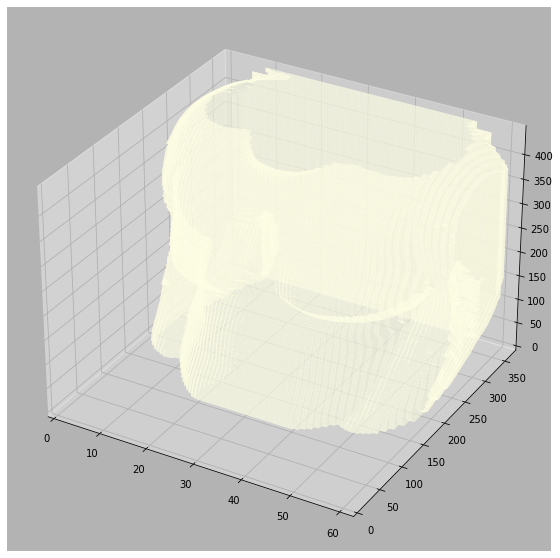

In [10]:
v, f = mesh(plot_array) # für normales 3d
threeD_display(v, f)

**5. Interaktivität**

Um unser 3D-Modell interaktiv zu gestalten und eine Rotation zu ermöglichen, gehen wir wie folgt vor.

Wir erstellen eine neue Funktion mit den Übergabewerten **verts** und **faces**.

`def threeD_interactive_display(verts, faces):`

In dieser Funktion weisen wir den Variablen **x,y,z** die Werte von der Ergebnisse der Funktion **zip()** mit dem Übergabewert ***verts** zu.

`x,y,z = zip(*verts)` 

Der Variablen **colormap** weisen wir die Farben zu, die wir nutzen wollen.

`colormap=['rgb(236, 236, 212)','rgb(236, 236, 212)']`

Der Variablen **fig** weisen wir die Werte der Funktion **create_trisurf()** zu. Die folgenden Werte übergeben wir:

`fig = create_trisurf(x=x, y=y, z=z, plot_edges=False, colormap=colormap, simplices=faces, backgroundcolor='rgb(64, 64, 64)')`

Anschließend plotten wir. Wir plotten mit der Funktion **show()** aus der **plotly** Bibliothek, diese haben wir am Anfang importiert und **pio** genannt.

`pio.show(fig)`

Da unsere Funktion fertig ist legen wir wieder Werte für **v** und **f** fest. 

`v, f = mesh(plot_array, 2)`

Es golgt der Aufruf der Funktion mit den Übergabewerten **v,f**.

`threeD_interactive_display(v, f)`

In [11]:
def threeD_interactive_display(verts, faces):
    x,y,z = zip(*verts) 
    colormap=['rgb(236, 236, 212)','rgb(236, 236, 212)']
    fig = create_trisurf(x=x, y=y, z=z, plot_edges=False, colormap=colormap, simplices=faces, backgroundcolor='rgb(64, 64, 64)')
    pio.show(fig)

In [12]:
v, f = mesh(plot_array, 2) 
threeD_interactive_display(v, f)

**Herzlichen Glückwunsch!**

Du bist nun am Ende des Workshops angekommen! Wir hoffen, es hat dir Spaß gemacht und dir gefallen deine Ergebnisse.

**Quellen:**<br>
[Wikipedia - Transversalebene](https://de.wikipedia.org/wiki/Transversalebene)